### Imports

In [2]:
%load_ext autoreload
%autoreload 2

import os
from typing import Tuple
import pandas as pd

from experimentation import get_experimentation_results

### Auxiliary Functions

In [3]:
def get_model_performance_stats(manip_category: str) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """Returns DataFrame with best, mean, and worst performing model on the specified category. And
    a Dataframe with the performance of all models on the specified category."""

    # Get all model results
    ov_res_path = os.path.join(os.getcwd(), './../nn_results/', manip_category, 'overall_results.json')
    ov_res_df = pd.read_json(ov_res_path)

    # Get best and worst performing model
    ov_res_df['mean_performance'] = (ov_res_df['Train'] + ov_res_df['Val'] + ov_res_df['Test'])/3
    ov_res_df.sort_values(by=['mean_performance', 'total_hidden_units'], inplace=True)
    best_model = ov_res_df.iloc[0]
    worst_model = ov_res_df.iloc[-1]

    # Get mean performing model
    ov_res_df['dist_to_mean'] = abs(ov_res_df['mean_performance'].mean() - ov_res_df['mean_performance'])
    ov_res_df.sort_values(by=['dist_to_mean'], inplace=True)

    mean_model = ov_res_df .iloc[0]

    model_performance = pd.DataFrame([best_model, mean_model, worst_model])
    model_performance.index = ['Best', 'Mean', 'Worst']

    return model_performance, ov_res_df

### Generate results

c:\Users\danie\Documents\daniel\universidad\9no_semestre\inteligencia_artificial\Detection-Of-Market-Manipulation\python_scripts\mynn\utils.py:284: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 3))


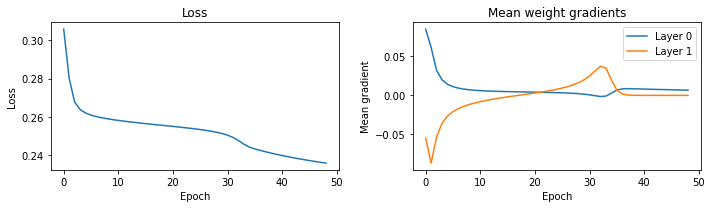

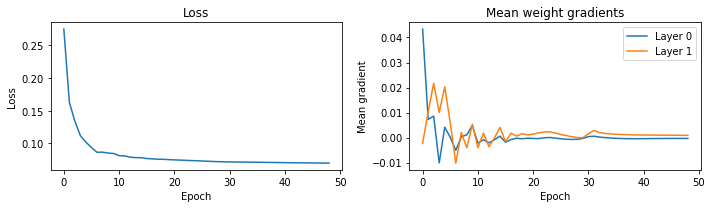

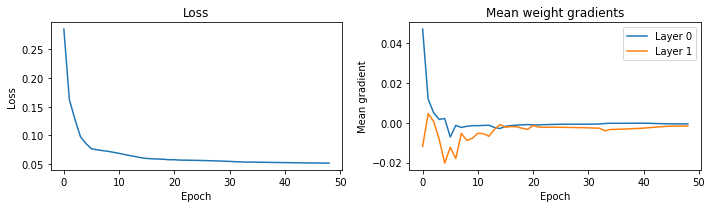

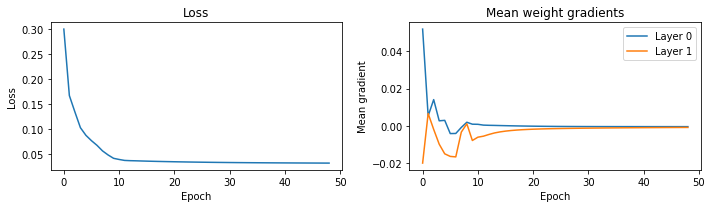

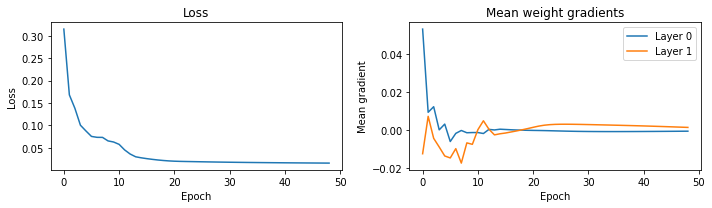

...

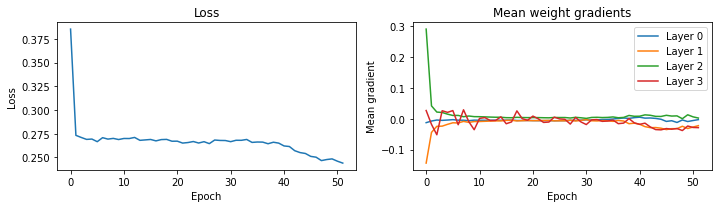

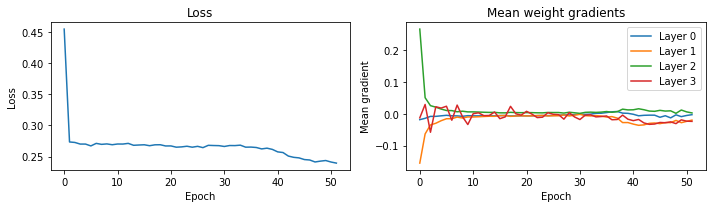

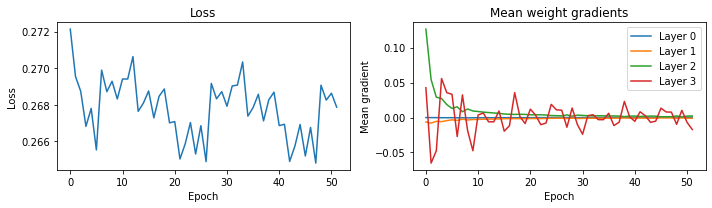

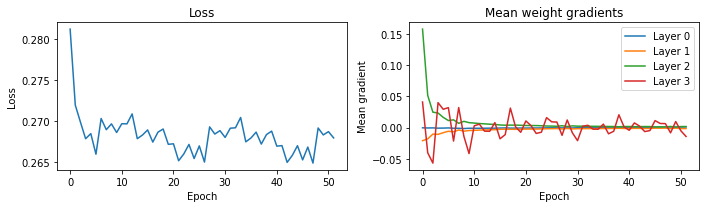

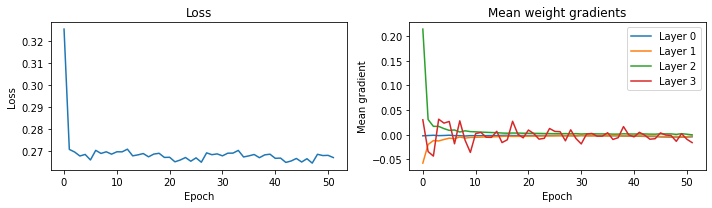

Error in callback <function flush_figures at 0x00000297343215E8> (for post_execute):


KeyboardInterrupt: 

In [4]:
categories = ["pump_and_dump", "poop_and_scoop", "wash_trade"]
thresholds = [0.75, 0.75, 0.75]
cone_flags = [True, False, False]

for category, threshold, cone_flag in zip(categories, thresholds, cone_flags):
    get_experimentation_results(category, threshold, cone_flag)


### Check model performance

In [ ]:
pad_model_performance, pad_ov_results = get_model_performance_stats('pump_and_dump')

pad_model_performance

,Train,Val,Test,max_epoch,stop_reason,num_hidden_layers,total_hidden_units,unit_combination,learning_rate,mean_performance,dist_to_mean
Best,0.028203,0.041595,0.041299,49,Max epochs reached,1,5,[5],0.2,0.037032,NaN
Mean,0.815468,0.142653,0.144701,7,Weight gradients converged,3,9,"[3, 5, 1]",0.9,0.367607,0.0621
Worst,0.797254,1.502843,1.503930,8,Weight gradients converged,3,11,"[5, 4, 2]",0.9,1.268009,NaN


In [ ]:
pas_model_performance, pas_ov_results = get_model_performance_stats('poop_and_scoop')

pas_model_performance

,Train,Val,Test,max_epoch,stop_reason,num_hidden_layers,total_hidden_units,unit_combination,learning_rate,mean_performance,dist_to_mean
Best,0.097741,0.055630,0.055511,49,Max epochs reached,1,5,[5],0.2,0.069627,NaN
Mean,0.834207,0.134022,0.132180,9,Weight gradients converged,2,5,"[2, 3]",0.2,0.366803,0.003175
Worst,0.767913,1.436764,1.443190,4,Weight gradients converged,2,9,"[4, 5]",0.9,1.215956,NaN


In [ ]:
wt_model_performance, wt_ov_results = get_model_performance_stats('wash_trade')

wt_model_performance

,Train,Val,Test,max_epoch,stop_reason,num_hidden_layers,total_hidden_units,unit_combination,learning_rate,mean_performance,dist_to_mean
Best,0.296647,0.085342,0.086080,49,Max epochs reached,1,5,[5],0.2,0.156023,NaN
Mean,0.423985,0.283718,0.274194,23,Weight gradients converged,2,8,"[5, 3]",0.2,0.327299,0.045531
Worst,0.780017,1.473371,1.478845,8,Weight gradients converged,2,8,"[3, 5]",0.5,1.244078,NaN
